In [1]:
import torch
import cv2
from segment_anything import SamAutomaticMaskGenerator, sam_model_registry, SamPredictor
import numpy as np
import matplotlib.pyplot as plt
import glob
import torch
import clip
from PIL import Image
from tqdm import tqdm
import functions as fnc
from importlib import reload

In [2]:
OutDIR='/DATA/vito/output/'
DataDIR='/DATA/vito/data/'
MODEL_TYPE = "vit_h"

if torch.cuda.is_available():
    DEVICE = torch.device('cuda:0')
    print('Currently running on GPU\nModel '+MODEL_TYPE)
else:
    DEVICE = torch.device('cpu')
    print('Currently running on CPU\nModel '+MODEL_TYPE)

if MODEL_TYPE == 'vit_h':
    CHECKPOINT_PATH = DataDIR+'MetaSAM/sam_vit_h_4b8939.pth'
elif MODEL_TYPE == 'vit_l':
    CHECKPOINT_PATH = DataDIR+'MetaSAM/sam_vit_l_0b3195.pth'
else:
    CHECKPOINT_PATH = DataDIR+'MetaSAM/sam_vit_b_01ec64.pth'

sam = sam_model_registry[MODEL_TYPE](checkpoint=CHECKPOINT_PATH)
sam.to(device=DEVICE)
mask_generator = SamAutomaticMaskGenerator(sam)


Currently running on GPU
Model vit_h


In [3]:
fn_img = glob.glob(DataDIR+'drone_ortho/*')
fn_img.sort()
print('Available images:')
for i, fn in enumerate(fn_img):
    print(f'{i}:' + fn.split("/")[-1])
print("---------------")
img_select=int(input("Select a image: "))
image = cv2.imread(fn_img[img_select])
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
print(fn_img[img_select].split("/")[-1]+' imported')

Available images:
0:512patched_LaPaya.npy
1:512patched_mask.npy
2:LaPaya_Apr2024_orthomosaic_5cm_UTM19S_WGS84.tif
3:big_clip.tif
4:small_clip1.tif
5:small_clip2.tif
---------------
big_clip.tif imported


In [ ]:
"--points-per-side" "Generate masks by sampling a grid over the image with this many points to a side."
"--points-per-batch" "How many input points to process simultaneously in one batch."
"--pred-iou-thresh" "Exclude masks with a predicted score from the model that is lower than this threshold."
"--stability-score-thresh" "Exclude masks with a stability score lower than this threshold."
"--stability-score-offset" "Larger values perturb the mask more when measuring stability score."
"--box-nms-thresh" "The overlap threshold for excluding a duplicate mask."
"--crop-n-layers" 
    "If >0, mask generation is run on smaller crops of the image to generate more masks. "
    "The value sets how many different scales to crop at."
"--crop-nms-thresh" "The overlap threshold for excluding duplicate masks across different crops."
"--crop-overlap-ratio" "Larger numbers mean image crops will overlap more."
"--crop-n-points-downscale-factor" "The number of points-per-side in each layer of crop is reduced by this factor."
"--min-mask-region-area"
    "Disconnected mask regions or holes with area smaller than this value "
    "in pixels are removed by postprocessing."

In [5]:
mask_generator_2 = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=64,
    pred_iou_thresh=0.80,
    stability_score_thresh=0.80,
    crop_n_layers=0,
    crop_n_points_downscale_factor=0,
    crop_overlap_ratio=0.1,
    min_mask_region_area=50,  # Requires open-cv to run post-processing
)

In [4]:
crop_size=512
i,j=0,2
cropped_image=image[crop_size*i:crop_size*(i+1),crop_size*j:crop_size*(j+1),:]
cropped_image.shape

(512, 512, 3)

In [5]:
img2D = cropped_image.reshape(512*512,3)
from sklearn.cluster import KMeans
kmeans_model = KMeans(n_clusters=2)
cluster_labels = kmeans_model.fit_predict(img2D)

/DATA/vito/.venv/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


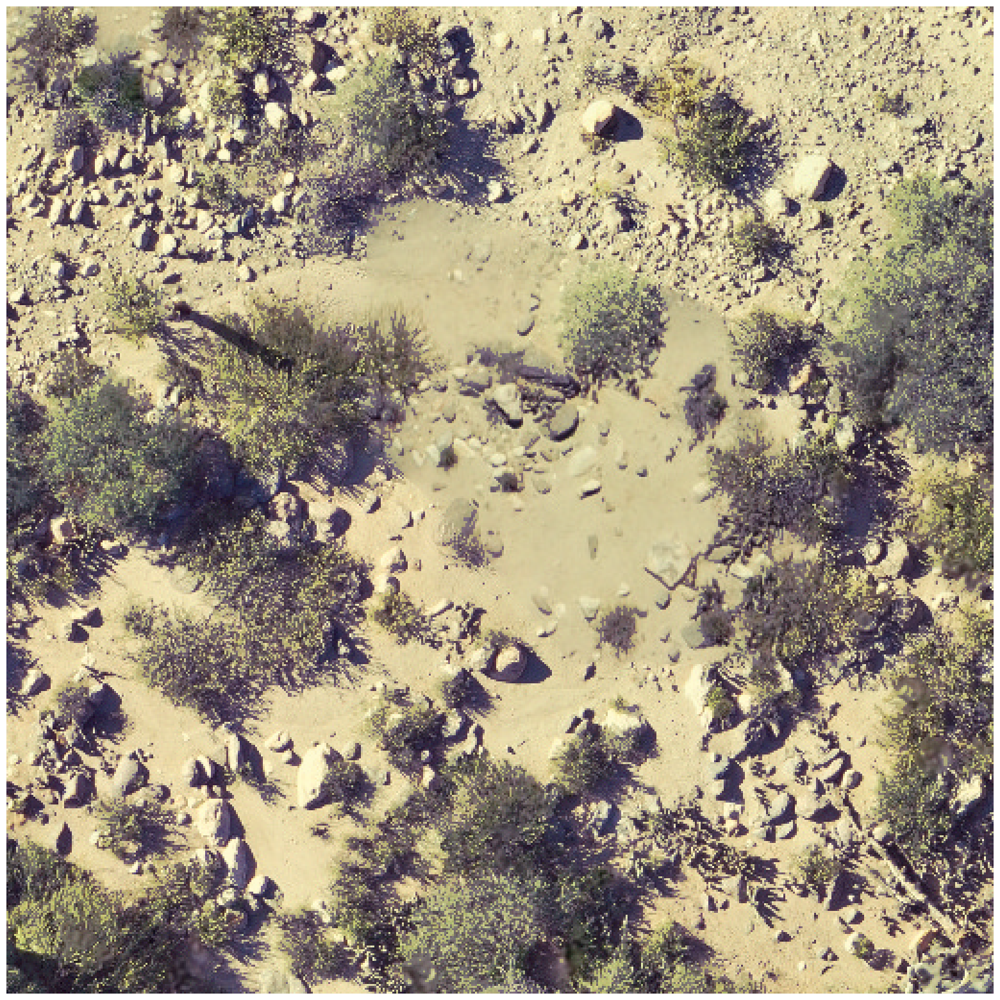

In [6]:
plt.figure(figsize=(20,20))
plt.imshow(cropped_image)
plt.imshow(np.reshape(cluster_labels,(512,512)) == 0, alpha=0.2)
plt.axis('off')
plt.show()

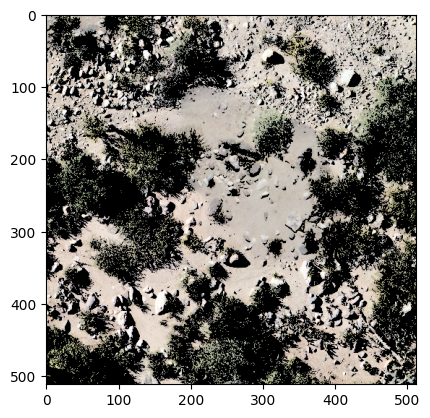

In [7]:
kmean_mask=np.array(np.reshape(cluster_labels,(512,512)) == 0)
kmean_masked_img=cropped_image.copy()
kmean_masked_img[kmean_mask==0]=0
plt.imshow(kmean_masked_img)

In [148]:
predictor = SamPredictor(sam)
predictor.set_image(cropped_image)

pred_masks, scores, logits = predictor.predict(
    point_coords=None,
    point_labels=None,
    mask_input=kmean_mask[None, :, :],#it wants dimension in (1,256,256)
    multimask_output=True,
)

RuntimeError: The size of tensor a (64) must match the size of tensor b (128) at non-singleton dimension 3

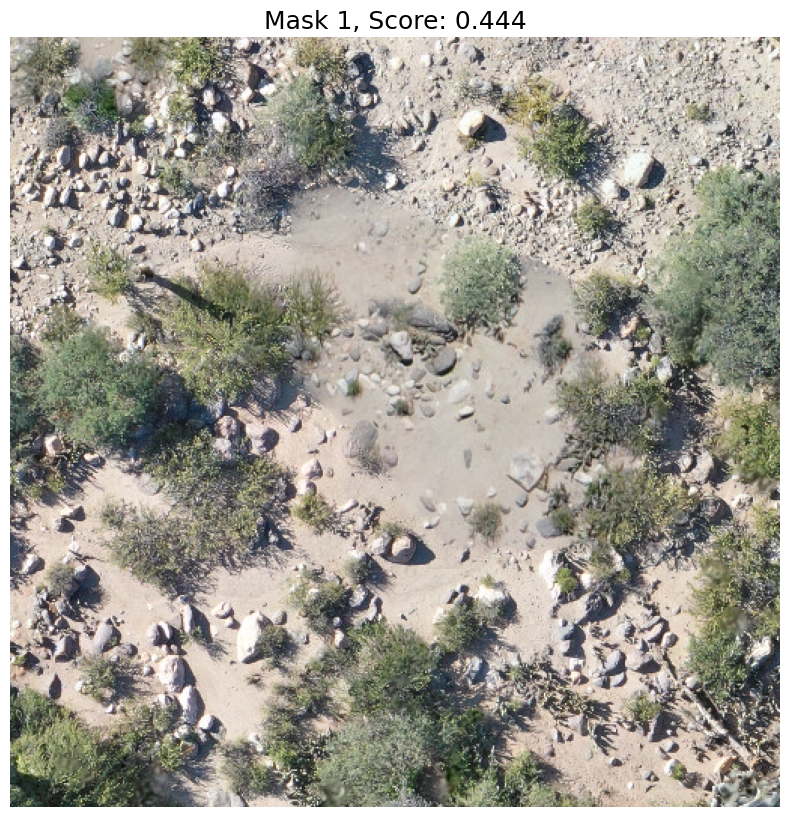

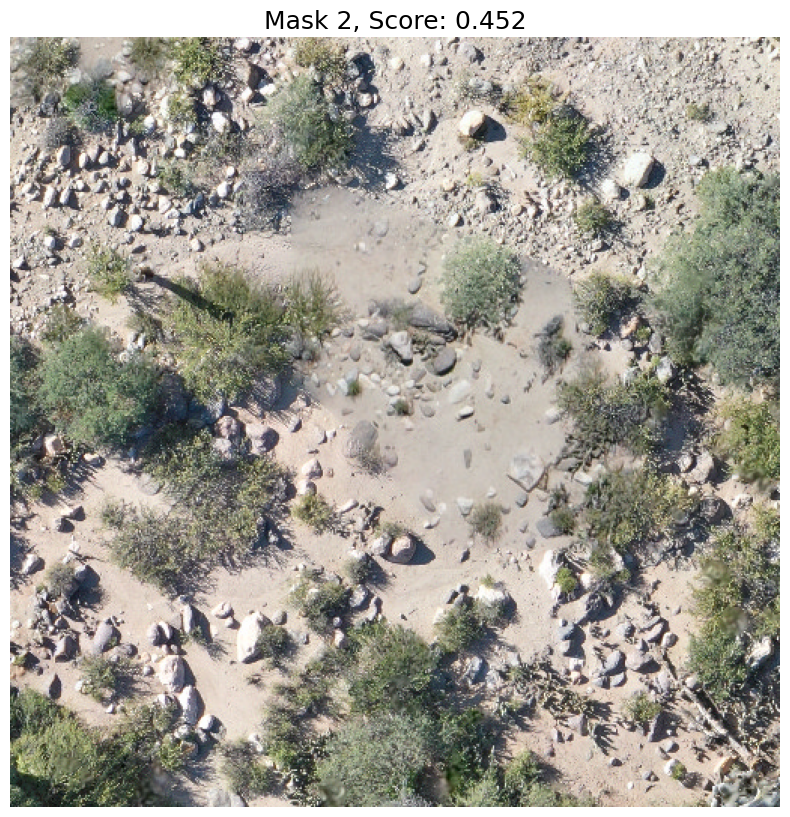

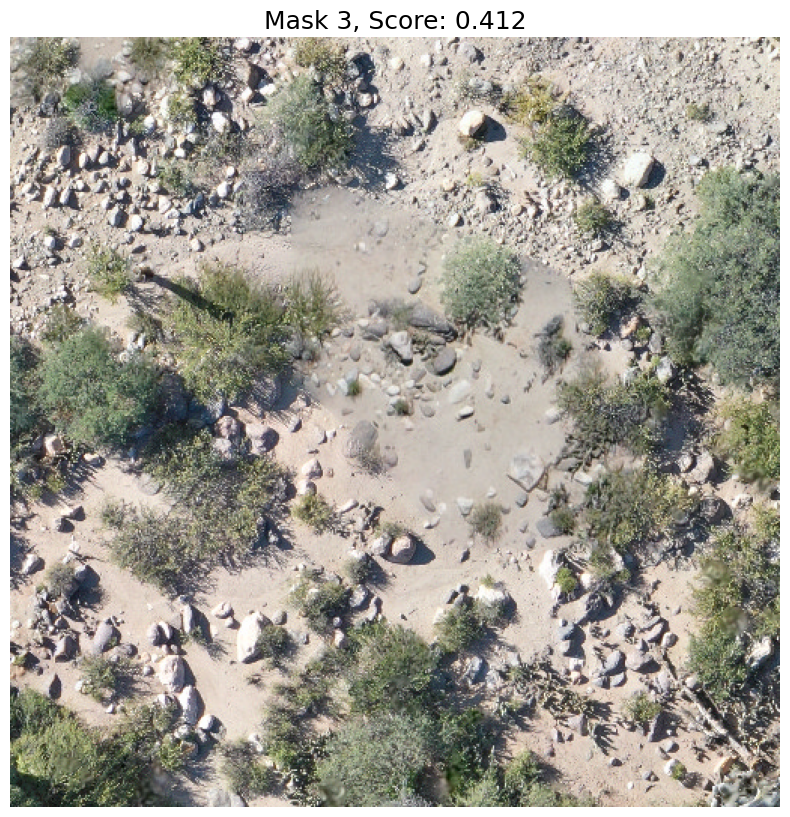

In [149]:
for i, (mask, score) in enumerate(zip(pred_masks, scores)):
    plt.figure(figsize=(10,10))
    plt.imshow(cropped_image)
    fnc.show_mask(mask, plt.gca())
    plt.title(f"Mask {i+1}, Score: {score:.3f}", fontsize=18)
    plt.axis('off')
    plt.show()  

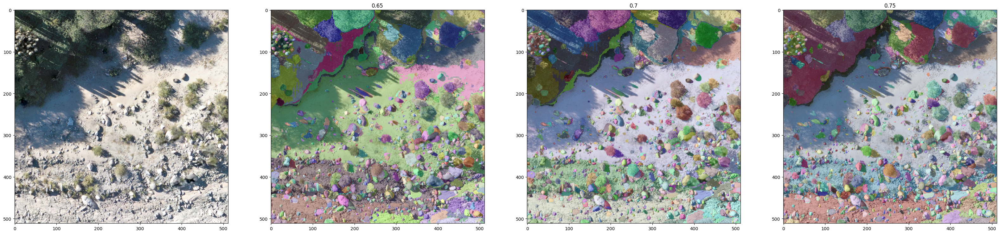

In [47]:
#parameter testing
fig, ax = plt.subplots(1,4,figsize=(40,20))
ax=ax.flatten()

ax[0].imshow(cropped_image)
test_p=[0.65,0.7,0.75]
#build generator
for i in range(3):
    mask_generator_2 = SamAutomaticMaskGenerator(
        model=sam,
        points_per_side=256,
        pred_iou_thresh=0.75,
        stability_score_thresh=test_p[i],
        crop_n_layers=0,
        crop_n_points_downscale_factor=0,
        crop_overlap_ratio=0,
        min_mask_region_area=50,
    )
    masks = mask_generator_2.generate(cropped_image)
    ax[i+1].imshow(cropped_image)
    fnc.show_anns_mod_ax(masks, ax[i+1])
    ax[i+1].set_title(f'{test_p[i]}')

#plt.axis('off')
plt.show() 


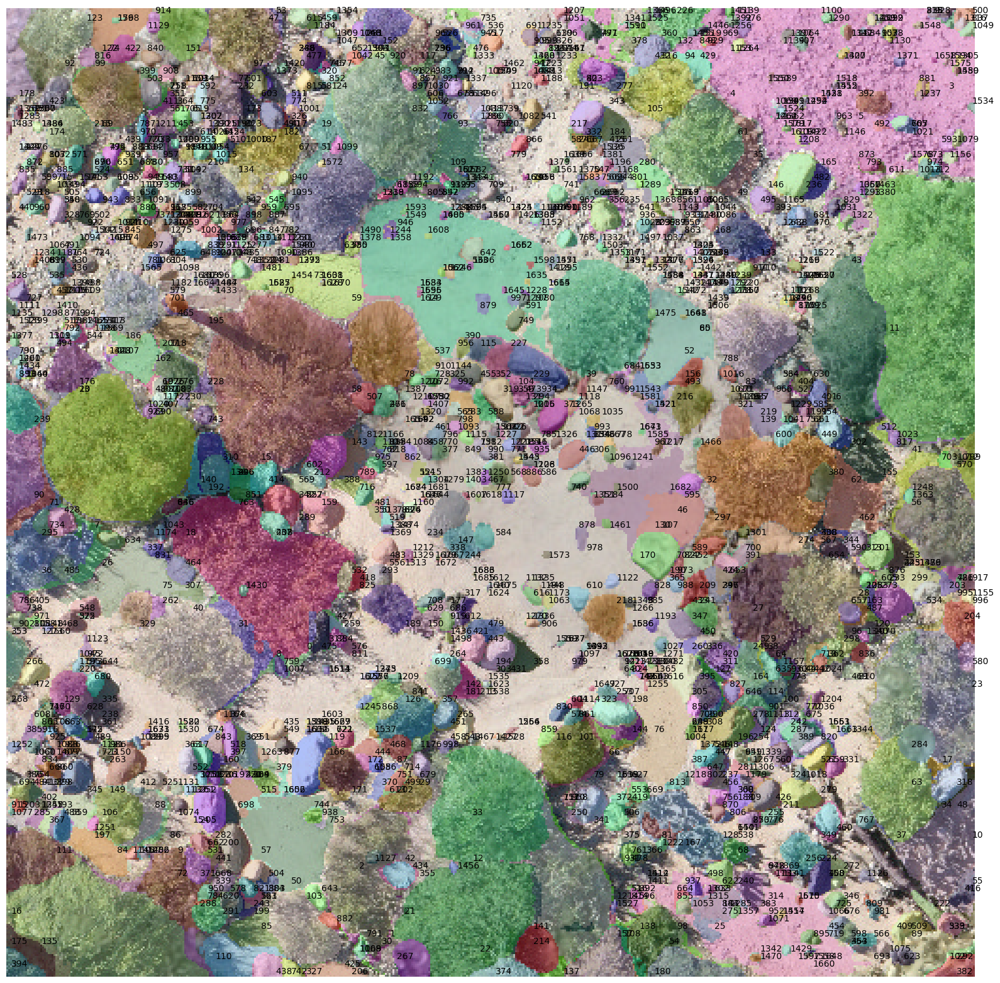

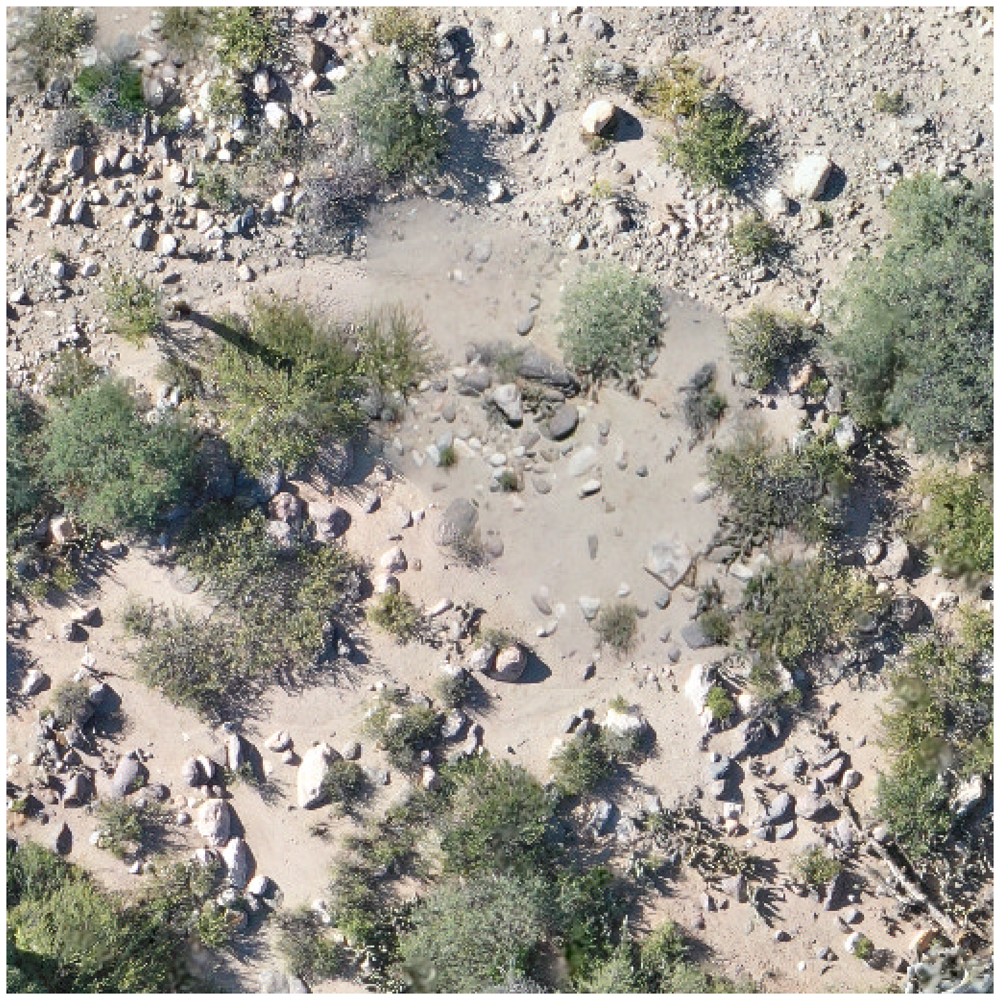

In [8]:
mask_generator = SamAutomaticMaskGenerator(
    model=sam,
    points_per_side=128,
    pred_iou_thresh=0.75,
    stability_score_thresh=0.75,
    crop_n_layers=0,
    crop_n_points_downscale_factor=0,
    crop_overlap_ratio=0,
    min_mask_region_area=50,
)
masks = fnc.samplot(cropped_image, mask_generator)

In [11]:
fnc=reload(fnc)

In [9]:
model, preprocess = clip.load("ViT-B/32", device=DEVICE)

In [46]:
model_list=clip.available_models()
model_list

['RN50',
 'RN101',
 'RN50x4',
 'RN50x16',
 'RN50x64',
 'ViT-B/32',
 'ViT-B/16',
 'ViT-L/14',
 'ViT-L/14@336px']

In [73]:
model, preprocess = clip.load(model_list[7], device=DEVICE)

In [74]:
kmean_apply=False
#load image
pil_image = Image.fromarray(cropped_image)
numpy_array = np.array(pil_image)

#define possible labels
labels=["an aerial photo of a stone", "an aerial photo of a small pebble stone"
        , "an aerial photo of a piece of sand surface"
        , "an aerial photo of some green plants", "dead bush"
        , "an aerial photo of a shrub","an irregular green object", "a top-down photo of a bush", "an aerial photo of a bush"
        , "a top-down photo of a shrub", "an aerial photo of some bushes", "wood stick", "wood branch"
        , "an aerial photo of desert surface", "an aerial photo of a sandy ground"
        , "a photo of the top of a bush", "an aerial photo of a small bush"]
text = clip.tokenize(labels).to(DEVICE)

#output
most_probables = []
probabilities = []
clip_probability_mask=np.zeros(cropped_image.shape[:-1])
WithBackground=True

#run prediction
for sg in tqdm(masks, desc='Processing', unit='segment'):
    sg_mask=sg['segmentation']

    #masking
    masked_image = np.copy(numpy_array)
    if kmean_apply:
        masked_image[kmean_mask==0]=0
    masked_image[sg_mask == 0] = 0

    #cropping
    notzero_indices = np.nonzero(masked_image)
    if notzero_indices[0].shape[0]>10:
        x_min = np.min(notzero_indices[0]).astype(int)
        x_max = np.max(notzero_indices[0]).astype(int)
        y_min = np.min(notzero_indices[1]).astype(int)
        y_max = np.max(notzero_indices[1]).astype(int)
        if WithBackground:
            clip_masked_image=numpy_array[x_min-5:x_max+5, y_min-5:y_max+5,:]
        else:
            clip_masked_image=masked_image[x_min-5:x_max+5, y_min-5:y_max+5,:]

        #convert back to PIL
        if ((clip_masked_image.shape[0]!=0)&(clip_masked_image.shape[1]!=0)):
            preprocessed_pil_image = Image.fromarray(clip_masked_image)

            #predict
            pre_image = preprocess(preprocessed_pil_image).unsqueeze(0).to(DEVICE)
            most_porbable, probability = fnc.classify_and_return_notable(pre_image, text, labels, model)
            most_probables.append(int(most_porbable))
            probabilities.append(probability)
            
            if int(most_porbable)<=1:
                clip_probability_mask[sg_mask]=probability
        else:
            most_probables.append(np.nan)
            probabilities.append(np.nan)

Processing:   0%|          | 0/1687 [00:00<?, ?segment/s]

Processing: 100%|██████████| 1687/1687 [01:18<00:00, 21.39segment/s]


In [34]:
#load image
pil_image = Image.fromarray(cropped_image)
numpy_array = np.array(pil_image)

#define possible labels
#labels=["rock", "sand", "vegetation", "bushes","grass", "desert", "ground"]
labels=["bushes", "sand"]
text = clip.tokenize(labels).to(DEVICE)

#output
probabilities = []
clip_probability_mask=np.zeros(cropped_image.shape[:-1])

#run prediction
for sg in tqdm(masks, desc='Processing', unit='segment'):
    sg_mask=sg['segmentation']

    #masking
    masked_image = np.copy(numpy_array)
    masked_image[sg_mask == 0] = 0

    #cropping
    notzero_indices = np.nonzero(masked_image)
    x_min = np.min(notzero_indices[0]).astype(int)
    x_max = np.max(notzero_indices[0]).astype(int)
    y_min = np.min(notzero_indices[1]).astype(int)
    y_max = np.max(notzero_indices[1]).astype(int)
    clip_masked_image=masked_image[x_min-10:x_max+10, y_min-10:y_max+10,:]

    #convert back to PIL
    if ((clip_masked_image.shape[0]!=0)&(clip_masked_image.shape[1]!=0)):
        preprocessed_pil_image = Image.fromarray(clip_masked_image)

        #predict
        pre_image = preprocess(preprocessed_pil_image).unsqueeze(0).to(DEVICE)
        with torch.no_grad():
            image_features = model.encode_image(pre_image)
            text_features = model.encode_text(text)
    
            logits_per_image, logits_per_text = model(pre_image, text)
            probs = logits_per_image.softmax(dim=-1).cpu().numpy()
            clip_probability_mask[sg_mask]=probs[0][0]
    else:
        probabilities.append(np.nan)

Processing:   0%|          | 0/1687 [00:00<?, ?segment/s]

Processing: 100%|██████████| 1687/1687 [00:48<00:00, 34.85segment/s]


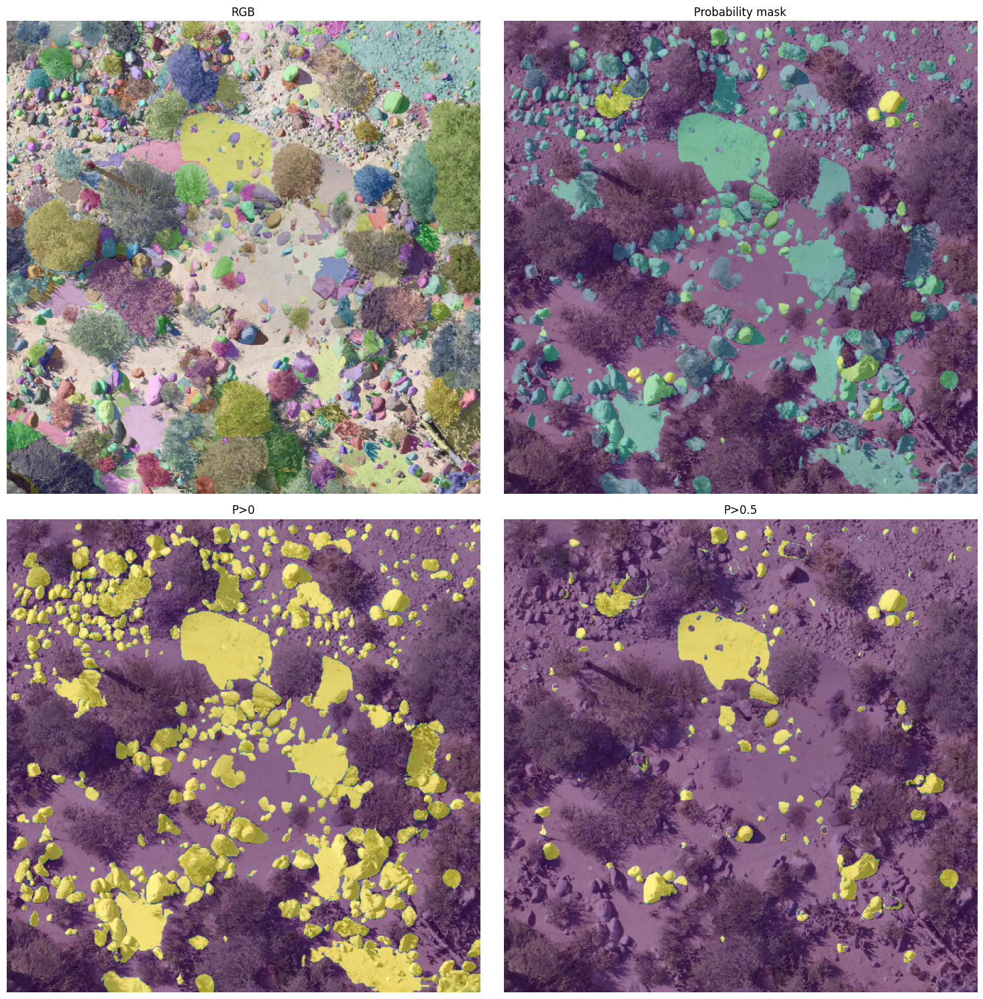

In [75]:
fnc.clip_plotting(cropped_image,clip_probability_mask, masks,0)

In [131]:
fnc=reload(fnc)

In [62]:
imagenet_templates = [
    'a bad photo of a {}.',
    'a photo of many {}.',
    'a sculpture of a {}.',
    'a photo of the hard to see {}.',
    'a low resolution photo of the {}.',
    'a rendering of a {}.',
    'graffiti of a {}.',
    'a bad photo of the {}.',
    'a cropped photo of the {}.',
    'a tattoo of a {}.',
    'the embroidered {}.',
    'a photo of a hard to see {}.',
    'a bright photo of a {}.',
    'a photo of a clean {}.',
    'a photo of a dirty {}.',
    'a dark photo of the {}.',
    'a drawing of a {}.',
    'a photo of my {}.',
    'the plastic {}.',
    'a photo of the cool {}.',
    'a close-up photo of a {}.',
    'a black and white photo of the {}.',
    'a painting of the {}.',
    'a painting of a {}.',
    'a pixelated photo of the {}.',
    'a sculpture of the {}.',
    'a bright photo of the {}.',
    'a cropped photo of a {}.',
    'a plastic {}.',
    'a photo of the dirty {}.',
    'a jpeg corrupted photo of a {}.',
    'a blurry photo of the {}.',
    'a photo of the {}.',
    'a good photo of the {}.',
    'a rendering of the {}.',
    'a {} in a video game.',
    'a photo of one {}.',
    'a doodle of a {}.',
    'a close-up photo of the {}.',
    'a photo of a {}.',
    'the origami {}.',
    'the {} in a video game.',
    'a sketch of a {}.',
    'a doodle of the {}.',
    'a origami {}.',
    'a low resolution photo of a {}.',
    'the toy {}.',
    'a rendition of the {}.',
    'a photo of the clean {}.',
    'a photo of a large {}.',
    'a rendition of a {}.',
    'a photo of a nice {}.',
    'a photo of a weird {}.',
    'a blurry photo of a {}.',
    'a cartoon {}.',
    'art of a {}.',
    'a sketch of the {}.',
    'a embroidered {}.',
    'a pixelated photo of a {}.',
    'itap of the {}.',
    'a jpeg corrupted photo of the {}.',
    'a good photo of a {}.',
    'a plushie {}.',
    'a photo of the nice {}.',
    'a photo of the small {}.',
    'a photo of the weird {}.',
    'the cartoon {}.',
    'art of the {}.',
    'a drawing of the {}.',
    'a photo of the large {}.',
    'a black and white photo of a {}.',
    'the plushie {}.',
    'a dark photo of a {}.',
    'itap of a {}.',
    'graffiti of the {}.',
    'a toy {}.',
    'itap of my {}.',
    'a photo of a cool {}.',
    'a photo of a small {}.',
    'a tattoo of the {}.',
]


In [87]:
#clip zero shot
image_classes = ["stone or rock"
                 , "wood branch"
                 #, "plant"
                 #, "green plant"
                 , "dry bush", "shrub", "bush", "green bush"
                 , "irregular clip of desert floor"
                 , "irregular clip of sandy surface"
                 , "gravel and sand"
                 ]


image_templates = [
    'an aerial photo of a {}.',
    'a clip of a {}.',
    'a top down photo of a {}.',
    'a pixelated photo of the {}.',
    'a blurry photo of a {}.',
    'a photo of some {}.',
    'a bad photo of a {}.',
    'a low resolution photo of a {}.',
    'a photo of a small {}.',
    'a photo of a big {}.',
    'a {} with a black background.',
    'a {} on a black board.',
]

zeroshot_weights = fnc.zeroshot_classifier(image_classes, image_templates, DEVICE, model)

100%|██████████| 9/9 [00:00<00:00, 92.50it/s]


Processing: 100%|██████████| 1687/1687 [00:30<00:00, 55.41segment/s]


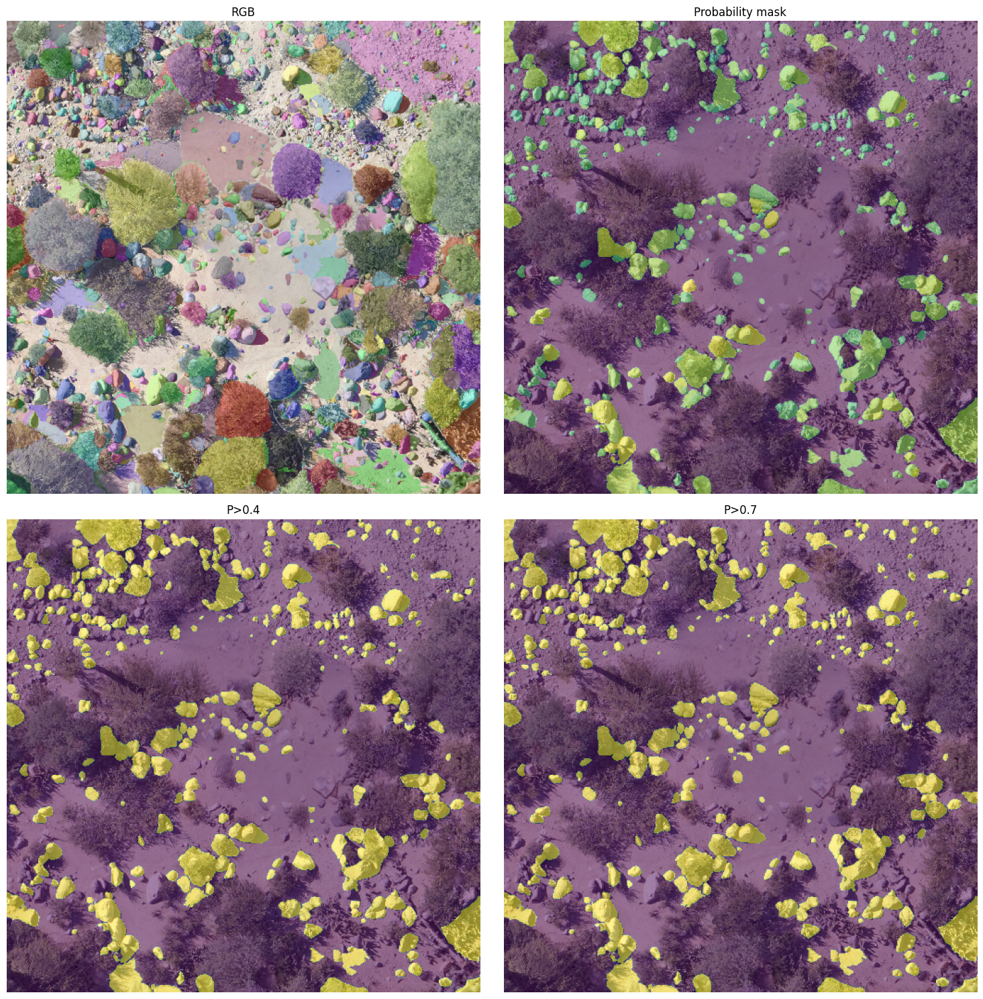

In [88]:
fnc=reload(fnc)
crop_size=512
pebble_index = 0
clip_top1_probability_mask, clip_probability_mask,_,_=fnc.clipzeroshot(cropped_image, masks, zeroshot_weights
                                                                       , crop_size, pebble_index, model
                                                                       , DEVICE, preprocess
                                                                       #, WithBackground=False
                                                                       , WithBackground=True
                                                                       #, pre_mask=kmean_mask)
                                                                       , pre_mask=None)

#save output
#np.save(OutDIR+'clip_probability_mask.npy', clip_probability_mask)
#np.save(OutDIR+'clip_most_probables.npy', most_probables)

fnc.clip_plotting(numpy_array,clip_top1_probability_mask, masks,0.4,0.7)
#fnc.clip_plotting(numpy_array,clip_probability_mask, masks)

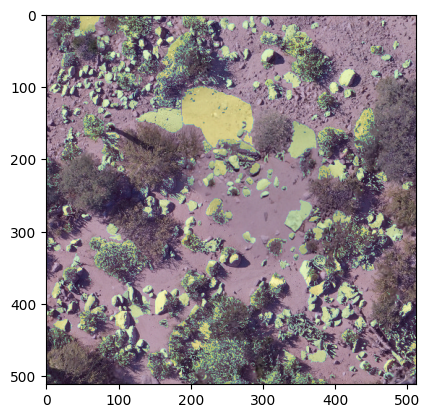

In [35]:
test=clip_top1_probability_mask.copy()
test[kmean_mask==0]=0
plt.imshow(cropped_image)
plt.imshow(test, alpha=0.3)
plt.show()

In [58]:
pebble_index = 0
#load image
pil_image = Image.fromarray(cropped_image)
numpy_array = np.array(pil_image)

#define possible labels
text = clip.tokenize(['a blurry photo of white stone']).to(DEVICE)

#output
imgs=[]
most_probables = []
probabilities = []
clip_probability_mask=np.zeros(cropped_image.shape[:-1])
clip_pebble_top1_probability_mask=np.zeros(cropped_image.shape[:-1])

#run prediction
for sg in tqdm(masks, desc='Processing', unit='segment'):
    sg_mask=sg['segmentation']

    #masking
    masked_image = np.copy(numpy_array)
    masked_image[sg_mask == 0] = 0

    #cropping
    notzero_indices = np.nonzero(masked_image)
    x_min = np.min(notzero_indices[0]).astype(int)
    x_max = np.max(notzero_indices[0]).astype(int)
    y_min = np.min(notzero_indices[1]).astype(int)
    y_max = np.max(notzero_indices[1]).astype(int)
    clip_masked_image=masked_image[x_min-10:x_max+10, y_min-10:y_max+10,:]

    #convert back to PIL
    if ((clip_masked_image.shape[0]!=0)&(clip_masked_image.shape[1]!=0)):
        preprocessed_pil_image = Image.fromarray(clip_masked_image)

        #predict
        imgs.append(preprocess(preprocessed_pil_image))#.unsqueeze(0))
        
with torch.no_grad():
  #prediction with one prompt, several images. We need to stack the images together
    logits_per_image, logits_per_text = model(torch.stack(imgs).to(DEVICE),text)
    probs = logits_per_text.softmax(dim=-1).cpu().numpy()

Processing:   6%|▌         | 97/1565 [00:00<00:12, 120.02segment/s]

Processing: 100%|██████████| 1565/1565 [00:12<00:00, 129.30segment/s]


In [59]:
clip_pebble_probability_mask=np.zeros(cropped_image.shape[:-1])
i=0
#run prediction
for sg in tqdm(masks, desc='Processing', unit='segment'):
    sg_mask=sg['segmentation']

    #masking
    masked_image = np.copy(numpy_array)
    masked_image[sg_mask == 0] = 0

    #cropping
    notzero_indices = np.nonzero(masked_image)
    x_min = np.min(notzero_indices[0]).astype(int)
    x_max = np.max(notzero_indices[0]).astype(int)
    y_min = np.min(notzero_indices[1]).astype(int)
    y_max = np.max(notzero_indices[1]).astype(int)
    clip_masked_image=masked_image[x_min-10:x_max+10, y_min-10:y_max+10,:]

    #convert back to PIL
    if ((clip_masked_image.shape[0]!=0)&(clip_masked_image.shape[1]!=0)):
        clip_pebble_probability_mask[sg_mask] = probs[0][i]
        i+=1

Processing: 100%|██████████| 1565/1565 [00:10<00:00, 143.24segment/s]
